<a href="https://colab.research.google.com/github/jimuelceleste/system-modeling-notes/blob/main/EnE%20305%20-%20Direction_Field_of_ASQ_SEIR_NLIR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Phase Portrait Analysis of ASQ-SEIR-NLIR

1.   List item

1.   List item

1.   List item
2.   List item


2.   List item


2.   List item



In [ ]:
# pip install be150

  Created wheel for be150: filename=be150-0.0.3-py2.py3-none-any.whl size=4469 sha256=0bc04456a25e31cf15443149a33e6df4fa66ff8f3fdf689c64ff50932fe7c3bd
  Stored in directory: /root/.cache/pip/wheels/57/00/c2/323715da8547b4345f10af3fd6f6a930b2bb6e870f62eb1dce
Successfully built be150


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 

# import be150

# import bokeh.io
# import bokeh.plotting

# bokeh.io.output_notebook()

# References 
- matplotlib.pyplot.streamplot 
  https://matplotlib.org/3.5.0/api/_as_gen/matplotlib.pyplot.streamplot.html#matplotlib-pyplot-streamplot
- 

In [ ]:
def get_asq_seir_nlir(params):
    beta = params["beta"]
    sigma = params["sigma"]
    gamma = params["gamma"]
    q = params["q"]
    u = params["u"]
    alpha = params["alpha"]
    epsilon = params["epsilon"]
  
    def asq_seir_nlir(t, y):
        s, e, i, r = y
        n = sum(y)
        return np.array([
            (-beta * q * s * i / n) / ((1 + alpha * s / n) * (1 + epsilon * i / n)), 
            ((beta * q * s * i / n) / ((1 + alpha * s / n) * (1 + epsilon * i / n))) - sigma * u * e, 
            sigma * u * e - gamma * i, 
            gamma * i
        ])
    return asq_seir_nlir

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app


Text(0.5, 1.0, 'R_0 = 1.36')

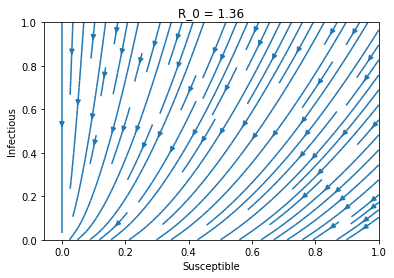

In [ ]:
x = np.linspace(0, 1, 100)
y = np.linspace(0, 1, 100)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

f = get_asq_seir_nlir({
    "beta": 2,
    "sigma": 0.28,
    "gamma": 0.33, 
    "q": 0.2,
    "u": 1,
    "alpha": 0.13,
    "epsilon": 0.7
})
e0 = 0 
r0 = 0
for i in range(xx.shape[0]):
    for j in range(xx.shape[1]):
        seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
        seir = f(None, seir0)
        u[i,j], v[i,j] = seir[[0, 2]]

plt.streamplot(x, y, u, v)
plt.xlabel("Susceptible")
plt.ylabel("Infectious")
plt.title("R_0 = 1.36")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app


Text(0.5, 1.0, 'R_0 = 0.085606')

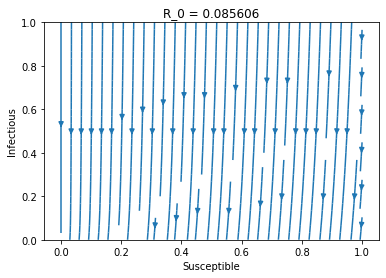

In [ ]:
x = np.linspace(0, 1, 100)
y = np.linspace(0, 1, 100)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

beta = 0.125
q = 0.2 
gamma = 0.33 
alpha = 0.13 

f = get_asq_seir_nlir({
    "beta": beta,
    "sigma": 0.28,
    "gamma": gamma, 
    "q": q,
    "u": 1,
    "alpha": alpha,
    "epsilon": 0.7
})
e0 = 0 
r0 = 0
for i in range(xx.shape[0]):
    for j in range(xx.shape[1]):
        seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
        seir = f(None, seir0)
        u[i,j], v[i,j] = seir[[0, 2]]

def get_r(beta, q, gamma, alpha):
    return beta * q / gamma * (1 + alpha)

plt.streamplot(x, y, u, v)
plt.xlabel("Susceptible")
plt.ylabel("Infectious")
plt.title("R_0 = %f" % (get_r(beta, q, gamma, alpha)))

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import sys
prefix = "/content/drive/My Drive/SMSL/EnE305 - System Modeling/MP5 - Special Topic"
sys.path.append(prefix)

Mounted at /content/drive


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in double_scalars
  from ipykernel import kernelapp as app
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app


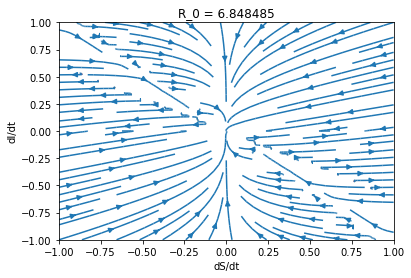

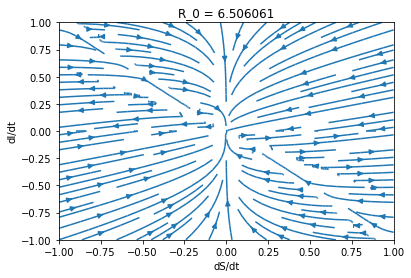

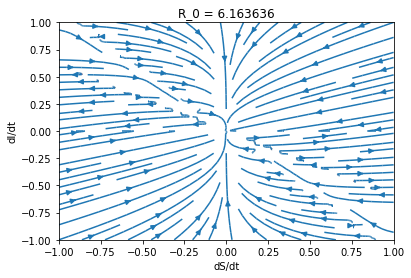

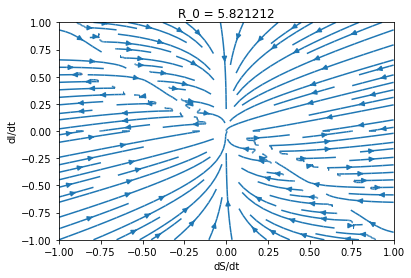

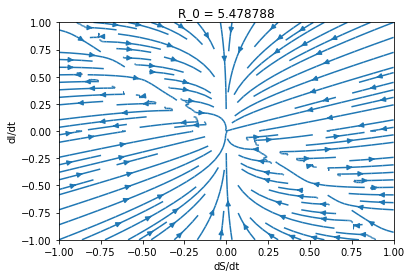

...

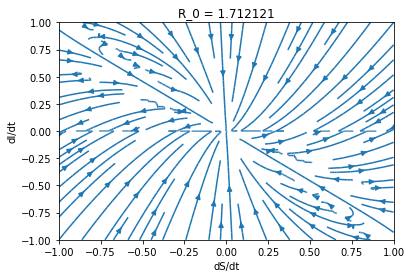

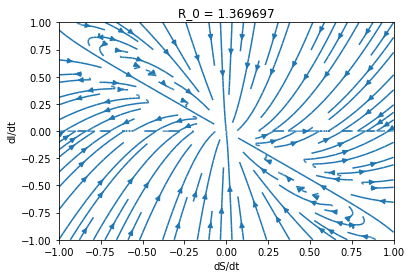

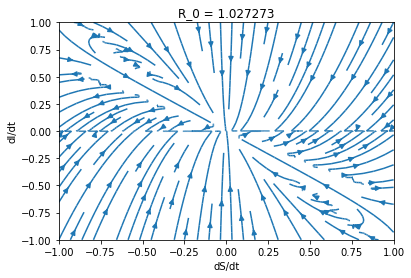

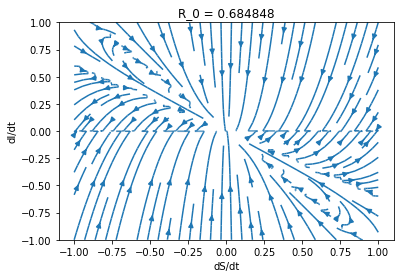

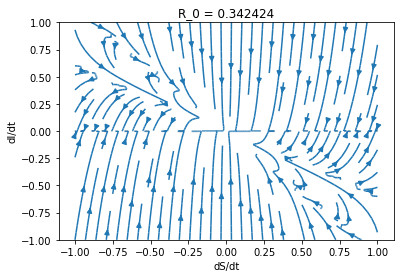

In [ ]:
x = np.linspace(-1, 1, 100)
y = np.linspace(-1, 1, 100)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

beta = 0.125
q = 0.2 
gamma = 0.33 
alpha = 0.13 

for beta in np.arange(10, 0, -0.5):
    f = get_asq_seir_nlir({
        "beta": beta,
        "sigma": 0.28,
        "gamma": gamma, 
        "q": q,
        "u": 1,
        "alpha": alpha,
        "epsilon": 0.7
    })
    e0 = 0 
    r0 = 0
    for i in range(xx.shape[0]):
        for j in range(xx.shape[1]):
            seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
            seir = f(None, seir0)
            u[i,j], v[i,j] = seir[[0, 2]]

    def get_r(beta, q, gamma, alpha):
        return beta * q / gamma * (1 + alpha)

    plt.figure()
    plt.streamplot(x, y, u, v)
    plt.xlabel("dS/dt")
    plt.ylabel("dI/dt")
    plt.title("R_0 = %f" % (get_r(beta, q, gamma, alpha)))
    plt.savefig(prefix + "/phase_portraits/si_graph_beta_%0.2f.png" % (beta))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app


Text(0.5, 1.0, 'R_0 = 0.000000')

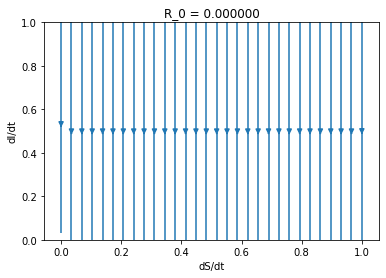

In [ ]:
x = np.linspace(0, 1, 100)
y = np.linspace(0, 1, 100)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

beta = 0
q = 0.2 
gamma = 0.33 
alpha = 0.13 

f = get_asq_seir_nlir({
    "beta": beta,
    "sigma": 0.28,
    "gamma": gamma, 
    "q": q,
    "u": 1,
    "alpha": alpha,
    "epsilon": 0.7
})
e0 = 0 
r0 = 0
for i in range(xx.shape[0]):
    for j in range(xx.shape[1]):
        seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
        seir = f(None, seir0)
        u[i,j], v[i,j] = seir[[0, 2]]

def get_r(beta, q, gamma, alpha):
    return beta * q / gamma * (1 + alpha)

plt.streamplot(x, y, u, v)
plt.xlabel("dS/dt")
plt.ylabel("dI/dt")
plt.title("R_0 = %f" % (get_r(beta, q, gamma, alpha)))

In [ ]:
x = np.linspace(-1, 1, 100)
y = np.linspace(-1, 1, 100)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

beta = 3 #0.125
q = 0.5 # 0.2 
gamma = 0.33 
alpha = 0.13
sigma = 0.28 
# omega = 0.5

def get_r(beta, q, gamma, alpha):
    return beta * q / gamma * (1 + alpha)

for beta in np.arange(0, 6, 1):
    f = get_asq_seir_nlir({
        "beta": beta,
        "sigma": sigma,
        "gamma": gamma, 
        "q": q,
        "u": 1,
        "alpha": alpha,
        "epsilon": 0.7, 
    })
    e0 = 0 
    r0 = 0
    for i in range(xx.shape[0]):
        for j in range(xx.shape[1]):
            seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
            seir = f(None, seir0)
            u[i,j], v[i,j] = seir[[0, 2]]

    # plt.figure(figsize=(10, 8))
    # strm = plt.streamplot(x, y, u, v, color=v, cmap='autumn', arrowstyle='wedge')
    # plt.colorbar(strm.lines)

    plt.figure(figsize=(10, 8))
    plt.streamplot(x, y, u, v)
    plt.axhline(y=0, color='r', linestyle='-')
    plt.axvline(x=0, color='r', linestyle='-')
    plt.xlabel("dS/dt")
    plt.ylabel("dI/dt")
    plt.title("R_0 = %f" % (get_r(beta, q, gamma, alpha)))
    # plt.savefig(prefix + "/phase_portraits_2/si_graph_beta_%0.2f.png" % (omega))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in double_scalars
  from ipykernel import kernelapp as app


# ASQ-SEIR-NLIR with reinfection 

Let $\omega$ be the reinfection rate.

In [ ]:
def get_asq_seir_nlir_with_reinfection(params):
    beta = params["beta"]
    sigma = params["sigma"]
    gamma = params["gamma"]
    q = params["q"]
    u = params["u"]
    alpha = params["alpha"]
    epsilon = params["epsilon"]
    omega = params["omega"]

    def asq_seir_nlir(t, y):
        s, e, i, r = y
        n = sum(y)
        return np.array([
            (-beta * q * s * i / n) / ((1 + alpha * s / n) * (1 + epsilon * i / n)) + omega * i, 
            ((beta * q * s * i / n) / ((1 + alpha * s / n) * (1 + epsilon * i / n))) - sigma * u * e, 
            sigma * u * e - gamma * i - omega * i, 
            gamma * i
        ])
    return asq_seir_nlir

def r_naught(beta, q, alpha, sigma, omega):
    return beta *  q / (1 + alpha) * (sigma + omega)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()


Text(0.5, 1.0, 'R_0 = 1.36')

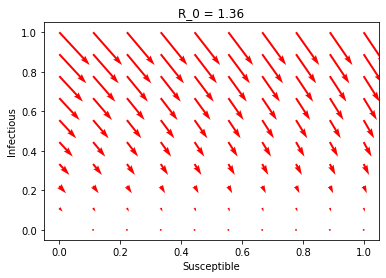

In [ ]:
x = np.linspace(0, 1, 10)
y = np.linspace(0, 1, 10)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

f = get_asq_seir_nlir_with_reinfection({
    "beta": 2,
    "sigma": 0.28,
    "gamma": 0.33, 
    "q": 0.2,
    "u": 1,
    "alpha": 0.13,
    "epsilon": 0.7, 
    "omega": 0.5
})
e0 = 0 
r0 = 0
for i in range(xx.shape[0]):
    for j in range(xx.shape[1]):
        seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
        seir = f(None, seir0)
        u[i,j], v[i,j] = seir[[0, 2]]

plt.streamplot(x, y, u, v)
plt.xlabel("Susceptible")
plt.ylabel("Infectious")
plt.title("R_0 = 1.36")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()


Text(0.5, 1.0, 'R_0 = infty')

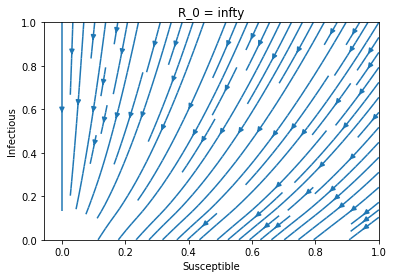

In [ ]:
x = np.linspace(0, 1, 10)
y = np.linspace(0, 1, 10)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

f = get_asq_seir_nlir_with_reinfection({
    "beta": 2,
    "sigma": 0,
    "gamma": 0.33, 
    "q": 0.2,
    "u": 1,
    "alpha": 0.13,
    "epsilon": 0.7, 
    "omega": 0
})
e0 = 0 
r0 = 0
for i in range(xx.shape[0]):
    for j in range(xx.shape[1]):
        seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
        seir = f(None, seir0)
        u[i,j], v[i,j] = seir[[0, 2]]

plt.streamplot(x, y, u, v)
plt.xlabel("Susceptible")
plt.ylabel("Infectious")
plt.title("R_0 = infty")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in double_scalars
  from ipykernel import kernelapp as app
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in double_scalars
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


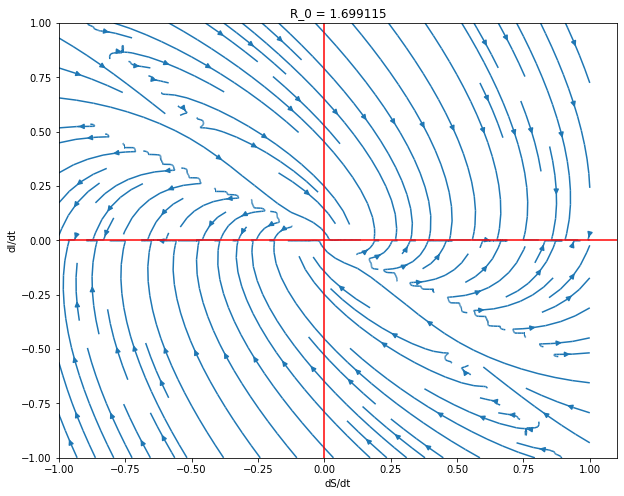

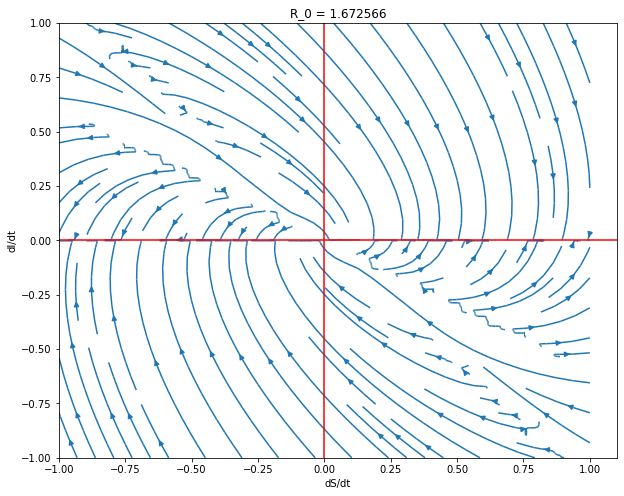

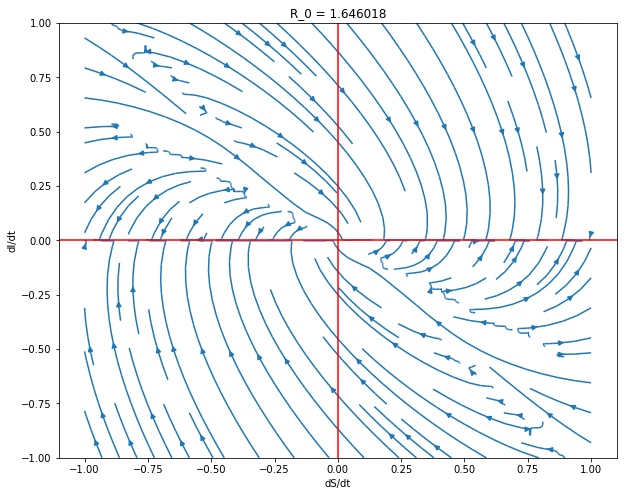

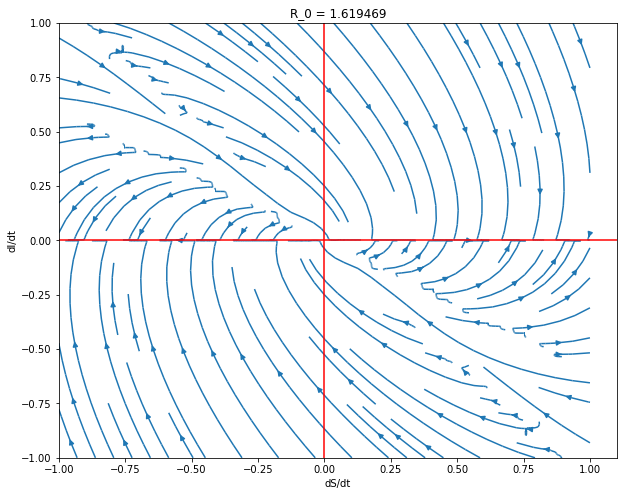

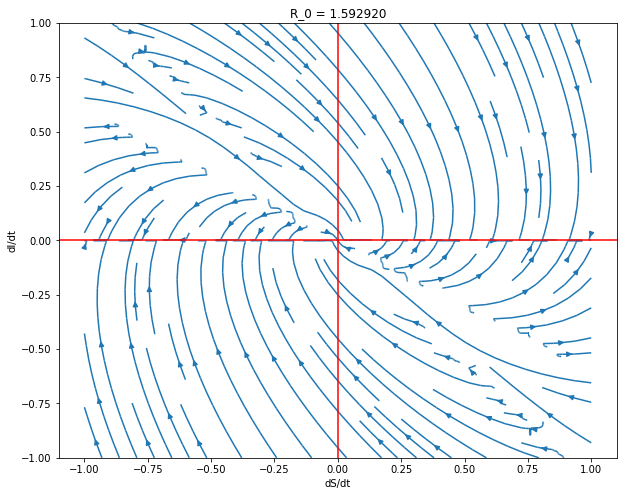

...

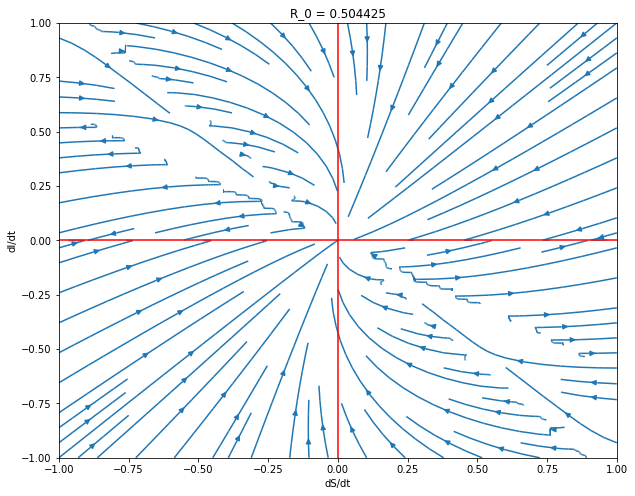

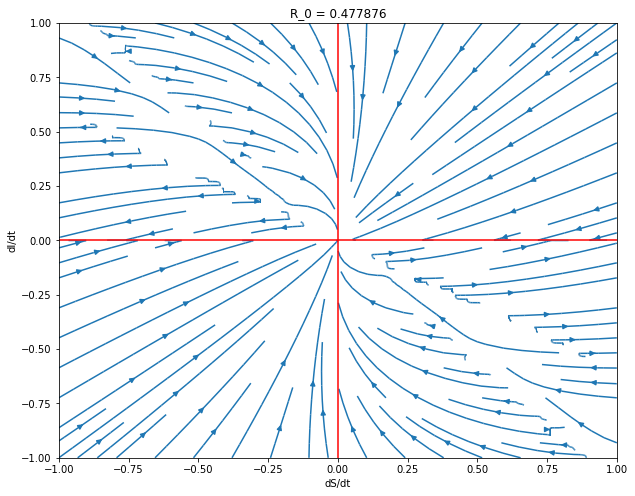

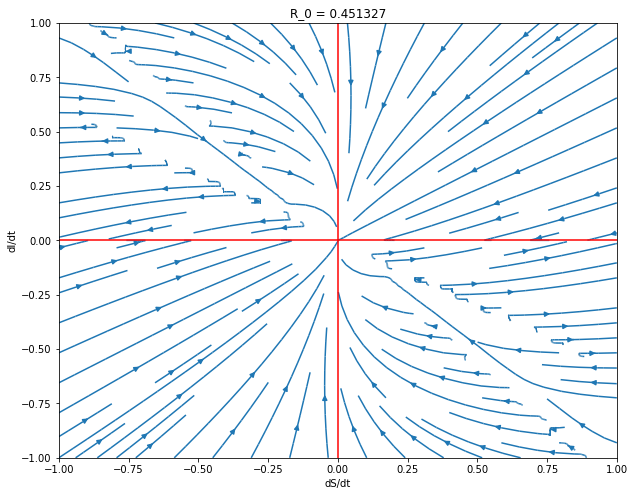

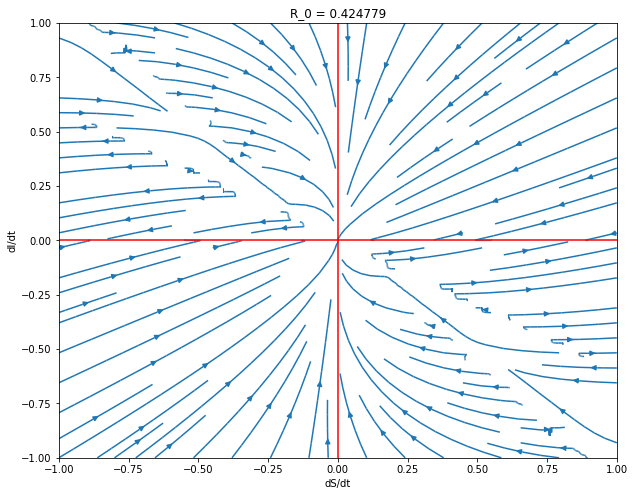

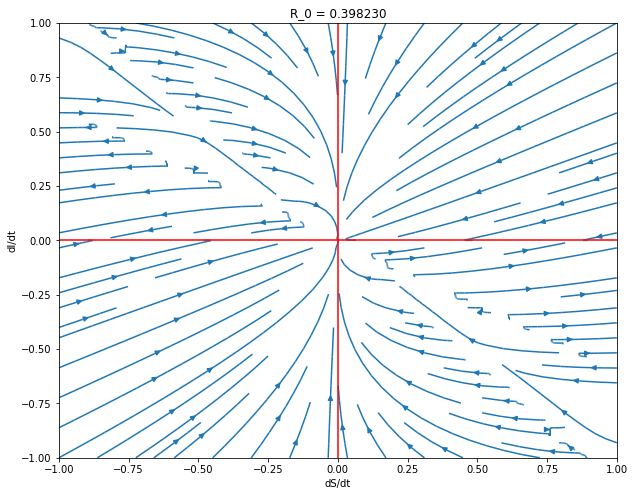

In [ ]:
x = np.linspace(-1, 1, 100)
y = np.linspace(-1, 1, 100)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

beta = 3 #0.125
q = 0.5 # 0.2 
gamma = 0.33 
alpha = 0.13
sigma = 0.28 
# omega = 0.5

for omega in np.arange(1, 0, -0.02):
    f = get_asq_seir_nlir_with_reinfection({
        "beta": beta,
        "sigma": sigma,
        "gamma": gamma, 
        "q": q,
        "u": 1,
        "alpha": alpha,
        "epsilon": 0.7, 
        "omega": omega
    })
    e0 = 0 
    r0 = 0
    for i in range(xx.shape[0]):
        for j in range(xx.shape[1]):
            seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
            seir = f(None, seir0)
            u[i,j], v[i,j] = seir[[0, 2]]

    # plt.figure(figsize=(10, 8))
    # strm = plt.streamplot(x, y, u, v, color=v, cmap='autumn', arrowstyle='wedge')
    # plt.colorbar(strm.lines)

    plt.figure(figsize=(10, 8))
    plt.streamplot(x, y, u, v)
    plt.axhline(y=0, color='r', linestyle='-')
    plt.axvline(x=0, color='r', linestyle='-')
    plt.xlabel("dS/dt")
    plt.ylabel("dI/dt")
    plt.title("R_0 = %f" % (r_naught(beta, q, alpha, sigma, omega)))
    plt.savefig(prefix + "/phase_portraits_with_reinfection/si_graph_beta_%0.2f.png" % (omega))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


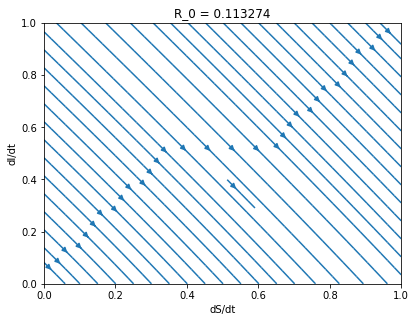

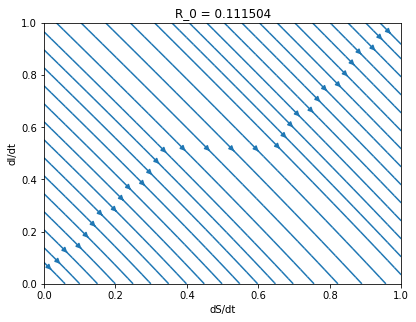

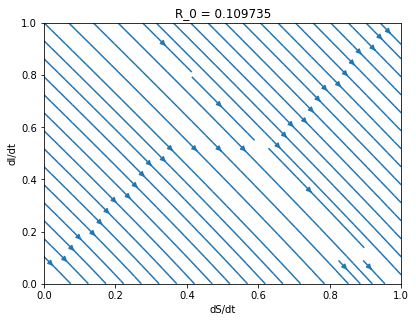

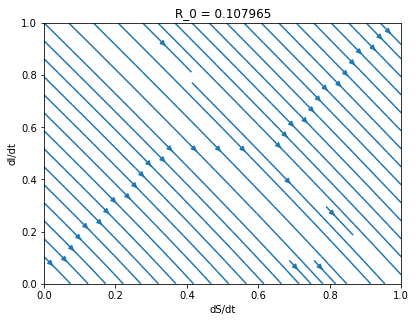

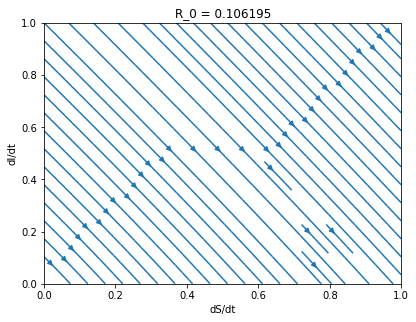

...

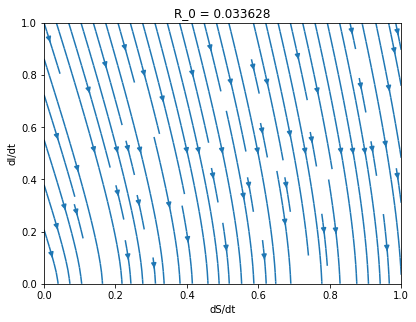

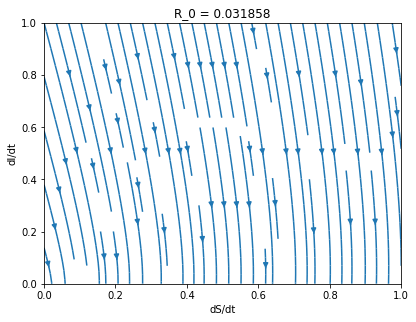

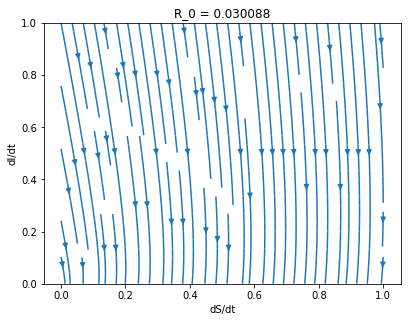

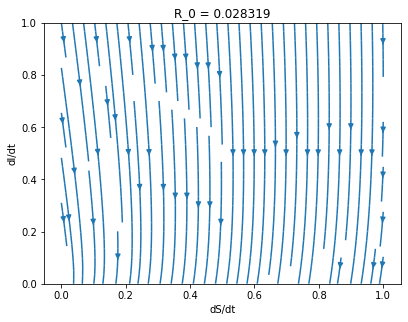

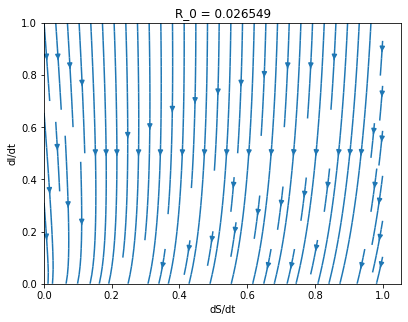

In [ ]:
x = np.linspace(0, 1, 100)
y = np.linspace(0, 1, 100)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

beta = 1 #0.125
q = 0.1 # 0.2 
gamma = 0.33 
alpha = 0.13
sigma = 0.28 
# omega = 0.5

for omega in np.arange(1, 0, -0.02):
    f = get_asq_seir_nlir_with_reinfection({
        "beta": beta,
        "sigma": sigma,
        "gamma": gamma, 
        "q": q,
        "u": 1,
        "alpha": alpha,
        "epsilon": 0.7, 
        "omega": omega
    })
    e0 = 0 
    r0 = 0
    for i in range(xx.shape[0]):
        for j in range(xx.shape[1]):
            seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
            seir = f(None, seir0)
            u[i,j], v[i,j] = seir[[0, 2]]

    # plt.figure(figsize=(10, 8))
    # strm = plt.streamplot(x, y, u, v, color=v, cmap='autumn', arrowstyle='wedge')
    # plt.colorbar(strm.lines)

    plt.figure(figsize=[6.4, 4.8])
    plt.streamplot(x, y, u, v)
    # plt.axhline(y=0, color='r', linestyle='-')
    # plt.axvline(x=0, color='r', linestyle='-')
    plt.xlabel("dS/dt")
    plt.ylabel("dI/dt")
    plt.title("R_0 = %f" % (r_naught(beta, q, alpha, sigma, omega)))
    plt.savefig(prefix + "/phase_portraits_with_reinfection/si_graph_beta_%0.2f.png" % (omega))

# ASQ-SEIR-NLIR with birth and death from other causes

- $b$ birth rate
- $d$ death rate 

In [ ]:
def get_asq_seir_nlir_with_reinfection(params):
    beta = params["beta"]
    sigma = params["sigma"]
    gamma = params["gamma"]
    q = params["q"]
    u = params["u"]
    alpha = params["alpha"]
    epsilon = params["epsilon"]
    b = params["b"]
    d = params["d"]

    def asq_seir_nlir(t, y):
        s, e, i, r = y
        n = sum(y)
        return np.array([
            (-beta * q * s * i / n) / ((1 + alpha * s / n) * (1 + epsilon * i / n)) + b * n - d * s, 
            ((beta * q * s * i / n) / ((1 + alpha * s / n) * (1 + epsilon * i / n))) - sigma * u * e - d * e, 
            sigma * u * e - gamma * i - d * i, 
            gamma * i - d * r
        ])
    return asq_seir_nlir

def r_naught(beta, q, alpha, sigma, omega):
    return beta *  q / (1 + alpha) * (sigma + omega)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in double_scalars


Text(0.5, 1.0, 'R_0 = 1.36')

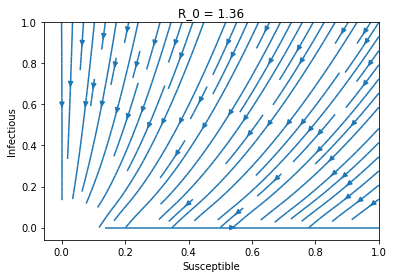

In [ ]:
x = np.linspace(0, 1, 10)
y = np.linspace(0, 1, 10)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

f = get_asq_seir_nlir_with_reinfection({
    "beta": 2,
    "sigma": 0.28,
    "gamma": 0.33, 
    "q": 0.2,
    "u": 1,
    "alpha": 0.13,
    "epsilon": 0.7, 
    "b": 0.001,
    "d": 0.00001
})
e0 = 0 
r0 = 0
for i in range(xx.shape[0]):
    for j in range(xx.shape[1]):
        seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
        seir = f(None, seir0)
        u[i,j], v[i,j] = seir[[0, 2]]

plt.streamplot(x, y, u, v)
plt.xlabel("Susceptible")
plt.ylabel("Infectious")
plt.title("R_0 = 1.36")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in double_scalars
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


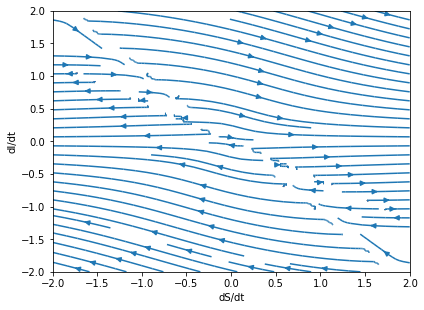

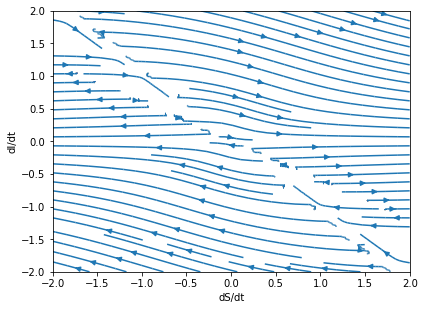

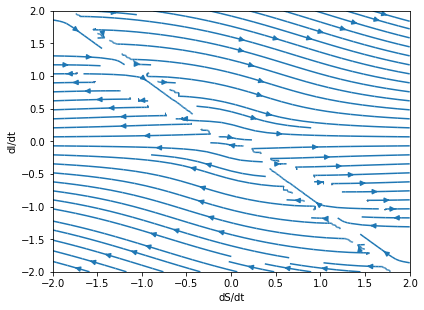

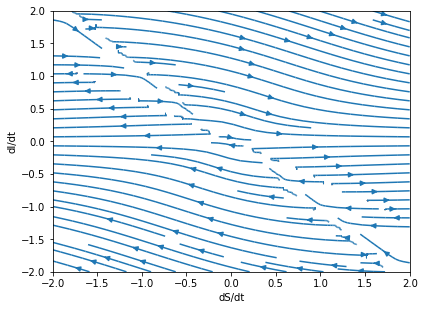

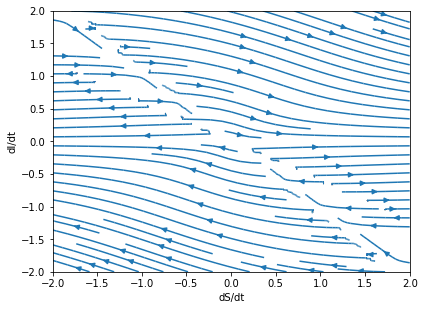

...

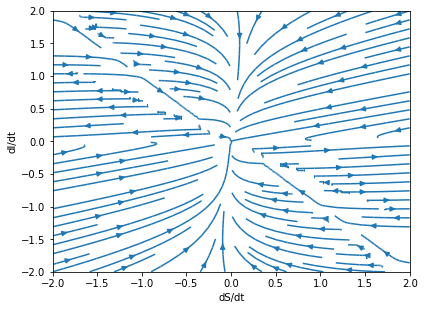

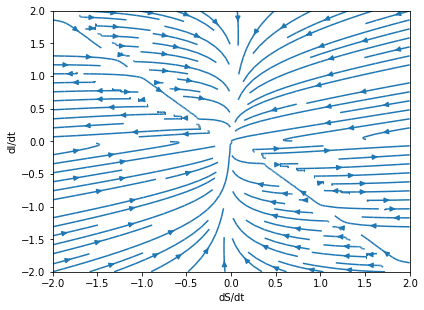

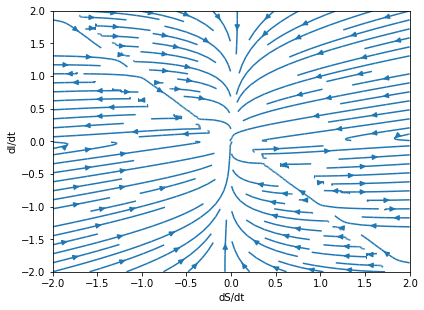

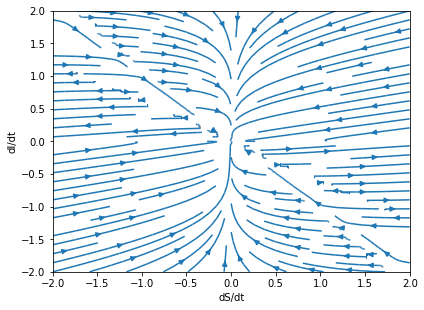

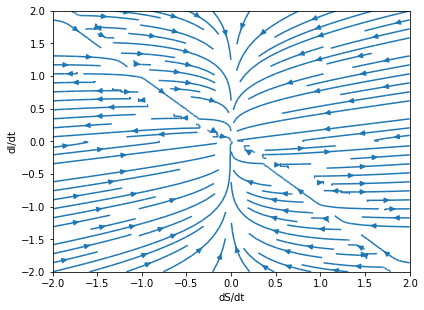

In [ ]:
x = np.linspace(-2, 2, 100)
y = np.linspace(-2, 2, 100)
xx, yy = np.meshgrid(x, y)

u = np.empty_like(xx)
v = np.empty_like(xx)

beta = 3 #0.125
q = 1 # 0.2 
gamma = 0.33 
alpha = 0.13
sigma = 0.28 
# b = 0.1
d = 0.00001
# omega = 0.5

for b in np.arange(1, 0, -0.02):
    f = get_asq_seir_nlir_with_reinfection({
        "beta": beta,
        "sigma": sigma,
        "gamma": gamma, 
        "q": q,
        "u": 1,
        "alpha": alpha,
        "epsilon": 0.7, 
        "b": b, 
        "d": d
    })
    e0 = 0 
    r0 = 0
    for i in range(xx.shape[0]):
        for j in range(xx.shape[1]):
            seir0 = np.array([xx[i,j], e0, yy[i,j], r0])
            seir = f(None, seir0)
            u[i,j], v[i,j] = seir[[0, 2]]

    # plt.figure(figsize=(10, 8))
    # strm = plt.streamplot(x, y, u, v, color=v, cmap='autumn', arrowstyle='wedge')
    # plt.colorbar(strm.lines)

    plt.figure(figsize=[6.4, 4.8])
    plt.streamplot(x, y, u, v)
    # plt.axhline(y=0, color='r', linestyle='-')
    # plt.axvline(x=0, color='r', linestyle='-')
    plt.xlabel("dS/dt")
    plt.ylabel("dI/dt")
    # plt.title("R_0 = %f" % (r_naught(beta, q, alpha, sigma, omega)))
    # plt.savefig(prefix + "/phase_portraits_with_reinfection/si_graph_beta_%0.2f.png" % (omega))